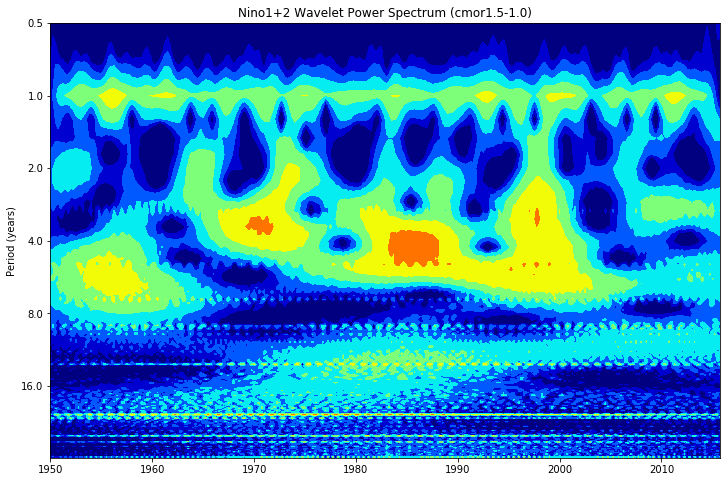

In [2]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-

import numpy as np
import matplotlib.pyplot as plt

import pywt

time, sst = pywt.data.nino()
dt = time[1] - time[0]

# Taken from http://nicolasfauchereau.github.io/climatecode/posts/wavelet-analysis-in-python/
wavelet = 'cmor1.5-1.0'
scales = np.arange(1, 128)

[cfs, frequencies] = pywt.cwt(sst, scales, wavelet, dt)
power = (abs(cfs)) ** 2

period = 1. / frequencies
levels = [0.0625, 0.125, 0.25, 0.5, 1, 2, 4, 8]
f, ax = plt.subplots(figsize=(12, 8))
ax.contourf(time, np.log2(period), np.log2(power), np.log2(levels),
            extend='both', cmap='jet')

ax.set_title('%s Wavelet Power Spectrum (%s)' % ('Nino1+2', wavelet))
ax.set_ylabel('Period (years)')
Yticks = 2 ** np.arange(np.ceil(np.log2(period.min())),
                        np.ceil(np.log2(period.max())))
ax.set_yticks(np.log2(Yticks))
ax.set_yticklabels(Yticks)
ax.invert_yaxis()
ylim = ax.get_ylim()
ax.set_ylim(ylim[0], -1)

plt.show()


In [3]:
time, sst

(array([1950.  , 1950.25, 1950.5 , 1950.75, 1951.  , 1951.25, 1951.5 ,
        1951.75, 1952.  , 1952.25, 1952.5 , 1952.75, 1953.  , 1953.25,
        1953.5 , 1953.75, 1954.  , 1954.25, 1954.5 , 1954.75, 1955.  ,
        1955.25, 1955.5 , 1955.75, 1956.  , 1956.25, 1956.5 , 1956.75,
        1957.  , 1957.25, 1957.5 , 1957.75, 1958.  , 1958.25, 1958.5 ,
        1958.75, 1959.  , 1959.25, 1959.5 , 1959.75, 1960.  , 1960.25,
        1960.5 , 1960.75, 1961.  , 1961.25, 1961.5 , 1961.75, 1962.  ,
        1962.25, 1962.5 , 1962.75, 1963.  , 1963.25, 1963.5 , 1963.75,
        1964.  , 1964.25, 1964.5 , 1964.75, 1965.  , 1965.25, 1965.5 ,
        1965.75, 1966.  , 1966.25, 1966.5 , 1966.75, 1967.  , 1967.25,
        1967.5 , 1967.75, 1968.  , 1968.25, 1968.5 , 1968.75, 1969.  ,
        1969.25, 1969.5 , 1969.75, 1970.  , 1970.25, 1970.5 , 1970.75,
        1971.  , 1971.25, 1971.5 , 1971.75, 1972.  , 1972.25, 1972.5 ,
        1972.75, 1973.  , 1973.25, 1973.5 , 1973.75, 1974.  , 1974.25,
      

# Pedestrian data
Wavelet analysis form http://nicolasfauchereau.github.io/climatecode/posts/wavelet-analysis-in-python/

- https://nbviewer.jupyter.org/urls/dl.dropbox.com/s/400j051n0sustcy/wavelet_test_ElNino3_Liu.ipynb
- http://ocgweb.marine.usf.edu/~liu/wavelet.html
- http://ocgweb.marine.usf.edu/~liu/Papers/Liu_etal_2007_JAOT_wavelet.pdf

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import pywt

In [6]:
# Reading data
db = pd.read_csv('_data\Pedestrian_Counting_System___2009_to_Present__counts_per_hour_.csv')
#grouped = db.groupby('Sensor_ID')
db.dtypes

ID                int64
Date_Time        object
Year              int64
Month            object
Mdate             int64
Day              object
Time              int64
Sensor_ID         int64
Sensor_Name      object
Hourly_Counts     int64
dtype: object

In [7]:
# Converting to datetime format -- to filter it
db['Date_Time'] = pd.to_datetime(db['Date_Time'], format='%m/%d/%Y %H:%M:%S %p')
db.set_index('Date_Time', inplace=True)
db.dtypes

ID                int64
Year              int64
Month            object
Mdate             int64
Day              object
Time              int64
Sensor_ID         int64
Sensor_Name      object
Hourly_Counts     int64
dtype: object

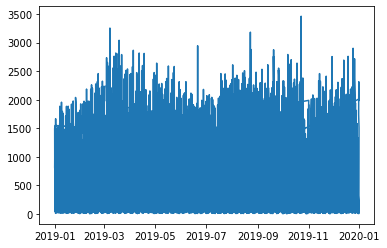

In [8]:
# Seleting a sample
sensor_id = 15
datasensor = db[db['Sensor_ID']==sensor_id]
datasensor = datasensor['2019']
plt.plot(datasensor.index, datasensor['Hourly_Counts'])

In [9]:
pywt.wavelist(kind='continuous')

['cgau1',
 'cgau2',
 'cgau3',
 'cgau4',
 'cgau5',
 'cgau6',
 'cgau7',
 'cgau8',
 'cmor',
 'fbsp',
 'gaus1',
 'gaus2',
 'gaus3',
 'gaus4',
 'gaus5',
 'gaus6',
 'gaus7',
 'gaus8',
 'mexh',
 'morl',
 'shan']

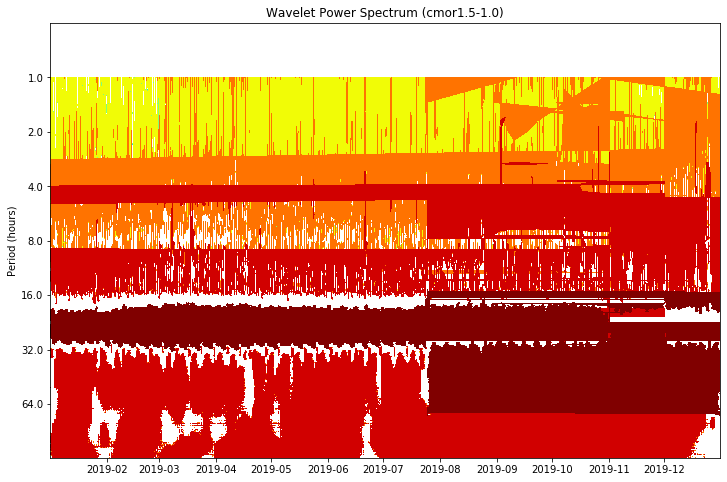

In [11]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-

time, sst = np.array(datasensor.index), np.array(datasensor['Hourly_Counts'])
dt = 1 # hour

wavelet = 'cmor1.5-1.0'
scales = np.arange(1, 128)

[cfs, frequencies] = pywt.cwt(sst, scales, wavelet, dt)
power = (abs(cfs)) ** 2

period = 1. / frequencies
levels = [0.0625, 0.125, 0.25, 0.5, 1, 2, 4, 8]
f, ax = plt.subplots(figsize=(12, 8))
ax.contourf(time, np.log2(period), np.log2(power), #np.log2(levels),
            extend='both', cmap='jet')

ax.set_title('Wavelet Power Spectrum (%s)' % (wavelet))
ax.set_ylabel('Period (hours)')
Yticks = 2 ** np.arange(np.ceil(np.log2(period.min())),
                        np.ceil(np.log2(period.max())))
ax.set_yticks(np.log2(Yticks))
ax.set_yticklabels(Yticks)
ax.invert_yaxis()
ylim = ax.get_ylim()
ax.set_ylim(ylim[0], -1)

plt.show()